In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pathlib
import pandas as pd
import warnings
import seaborn as sns
from torch.utils.data import DataLoader, Dataset
from tqdm import tqdm
from plotly.subplots import make_subplots
import plotly.graph_objects as go


warnings.filterwarnings("ignore")

In [2]:
import importlib
import Scripts
importlib.reload(Scripts)
import torch

# importlib.reload(Scripts.Config.core)

from Scripts.Config.core import FILE_PATHS
from Scripts.DataLoader.custom_dataset import IMDBDataset, MyCollate
from Scripts.utils import plot_top_n_squared_images

# Functions

In [ ]:
def calculate_mean_image(dataloader):
    """
    Calculates the mean image of a specific dataloader

    Args:
        dataloader (DataLoader): The dataloader to calculate the mean image of

    Returns:
        torch.Tensor: The mean image
    """
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    mean_images = []
    for batch in tqdm(dataloader):
        images = batch[0].to(device)
        mean_image_for_batch = torch.mean(images, dim=0)
        mean_images.append(mean_image_for_batch)

    mean_image = torch.mean(torch.stack(mean_images), dim=0)
    mean_image = mean_image.transpose(0, 2)
    return mean_image

def plot_top_n_squared_images(dataloader, title, n=9):
    """
    Plots n^2 random images from a specific dataloader

    Args:
        dataloader (DataLoader): The dataloader to plot the images from
        title (str): The title of the plot
        n (int, optional): The number of images to plot. Defaults to 9.
    """
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    images = []
    assert dataloader.batch_size > n**2
    batch = next(iter(dataloader))

    for i in range(n**2):
        image = batch[0][i].transpose(0, 2).to("cpu")
        images.append(image)

    fig, axes = plt.subplots(n, n, figsize=(10, 10))
    for i, ax in enumerate(axes.flat):
        ax.imshow(images[i].numpy().astype(int))
        ax.set_axis_off()
    plt.tight_layout()
    plt.suptitle(title, fontsize=16, y=1.05)
    plt.show()

# Load Data

In [3]:
# TODO: write in README.md that cleaning step for metadata is inspired by htis notebook
# TODO: when making train/test splitter class make sure it is in utils, and it has unseen celbs in test set

In [4]:
df = pd.read_csv(FILE_PATHS["metadata_all_uncleaned"])

In [6]:
df.head()

,image_path,age,gender,face_score,face_locations,celeb_id,second_face_score,dob,date_photo_taken
0,01/nm0000001_rm124825600_1899-5-10_1968.jpg,69.0,1.0,1.459693,[[1072.926 161.838 1214.784 303.696]],6488.0,1.118973,1899,1968.0
1,01/nm0000001_rm3343756032_1899-5-10_1970.jpg,71.0,1.0,2.543198,[[477.184 100.352 622.592 245.76 ]],6488.0,1.852008,1899,1970.0
2,01/nm0000001_rm577153792_1899-5-10_1968.jpg,69.0,1.0,3.455579,[[114.96964309 114.96964309 451.68657236 451.6...,6488.0,2.985660,1899,1968.0
3,02/nm0000002_rm1075631616_1924-9-16_1991.jpg,67.0,0.0,3.490563,[[ 686.67682059 458.46721373 1198.10043604 9...,11516.0,1.345335,1924,1991.0
4,02/nm0000002_rm1346607872_1924-9-16_2004.jpg,80.0,0.0,3.479189,[[ 78.23569407 52.33512938 194.25423516 168.3...,11516.0,NaN,1924,2004.0


# Basic filtering

In [7]:
df = df.dropna(subset=['age', 'gender','face_score'])
# remove -inf and inf values
df = df[~df.isin([np.inf, -np.inf]).any(axis=1)]
# convert dtypes
df['age'] = df['age'].astype(int)
df['gender'] = df['gender'].astype(int)
df['dob'] = pd.to_datetime(df['dob'], format='%Y')
df['date_photo_taken'] = pd.to_datetime(df['date_photo_taken'], format='%Y')

df = df[df['age'].isin(range(1,101))]

### Multiple Genders

In [8]:
# TODO: make sure every celeb_id has same dob
any_celeb_id_with_multiple_genders = any(df.groupby('celeb_id')['gender'].nunique()>1)
print(f'Are there celb_ids with multiple genders: {any_celeb_id_with_multiple_genders}')

Are there celb_ids with multiple genders: False


### Multiple DOB's

In [11]:
df.groupby('celeb_id')['dob'].nunique().value_counts()

dob
1    15632
Name: count, dtype: int64

There seems to be multiple DOB's for same celb_id, let's drop these:

In [10]:
# There seems to be multiple DOB's for same celb_id, let's drop these:
# drop false
df_dob_per_celeb_id_count = (df.groupby('celeb_id')['dob'].nunique()>1)
celeb_ids_with_multiple_dobs = df_dob_per_celeb_id_count[df_dob_per_celeb_id_count==True].index

df = df[~df['celeb_id'].isin(celeb_ids_with_multiple_dobs)]

# Face_score

The MatLab Metadata comes with face_scores for each image, we need to make a decision if we wish to filter down on this? Bear in mind that this score comes from an already trained neuralnetwork so it cannot be taken as 100% ground truth

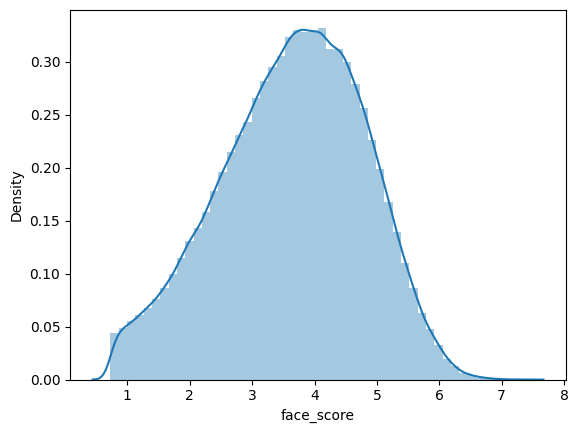

In [12]:
sns.distplot(df['face_score'])
plt.show()

 10%|▉         | 3/31 [00:07<01:14,  2.65s/it]


KeyboardInterrupt: 

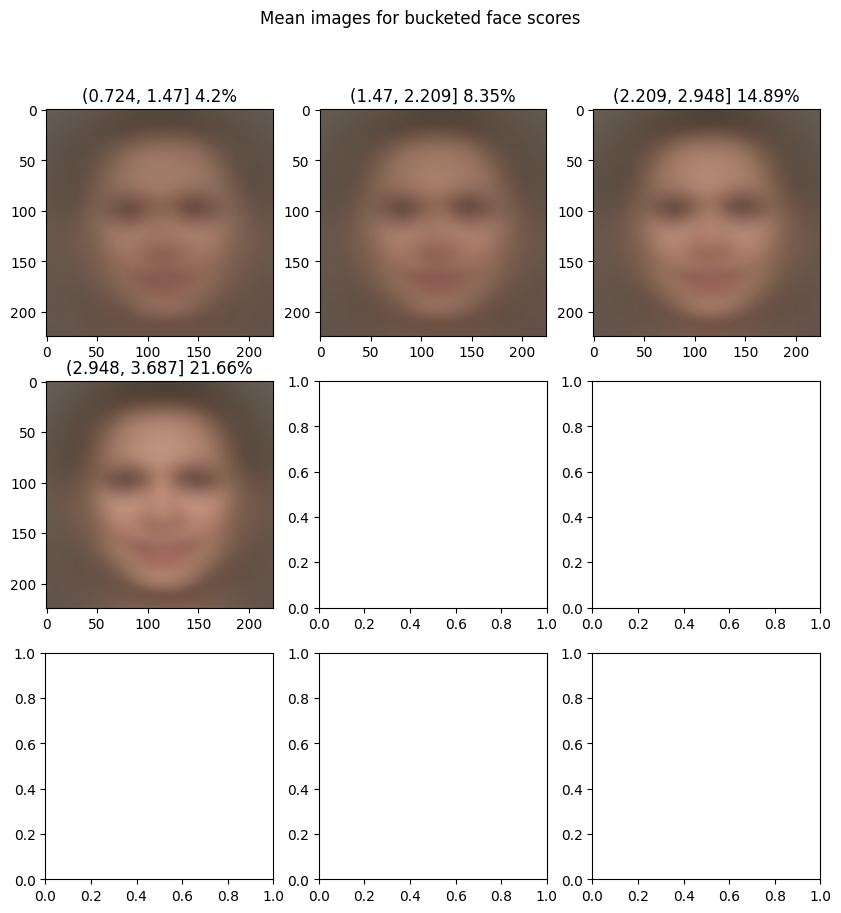

In [15]:
# plot mean image for each bucketed face score
bucketed_face_scores = pd.cut(df['face_score'], bins=9)
df['bucketed_face_scores'] = bucketed_face_scores
df['bucketed_face_scores'].value_counts()
# order buckets

intervals = df['bucketed_face_scores'].unique()
# sort intervals in ascending order
intervals = sorted(intervals)
# make subplots
fig, axs = plt.subplots(3,3, figsize=(10, 10))
plt.suptitle('Mean images for bucketed face scores')

for row in range(1,4):
    for col in range(1,4):

        bucket = intervals.pop(0)
        df_bucket = df[df['bucketed_face_scores'] == bucket]
        percent_of_data = round(100*len(df_bucket) / len(df),2)

        dataset = IMDBDataset(df_bucket, premean=True)
        dataloader = DataLoader(dataset, batch_size=2000, shuffle=True, collate_fn=MyCollate(2000))

        mean_image = calculate_mean_image(dataloader)
        mean_image = mean_image.to('cpu')
        mean_image = mean_image.numpy().astype(int)

        axs[row-1, col-1].imshow(mean_image)
        axs[row-1, col-1].set_title(str(bucket)+' '+str(percent_of_data)+'%')

plt.savefig('Data/mean_images_bucketed_face_scores.png')
plt.tight_layout()
plt.show()



Looks like mean image is getting sharper with a higher face score, lets see how some random individual images do from each bucket

In [14]:
n=9
intervals = df['bucketed_face_scores'].unique()
# sort intervals in ascending order
intervals = sorted(intervals)

for interval in intervals:
    df_interval = df[df['bucketed_face_scores'] == interval]
    dataset = IMDBDataset(df_interval, premean=True)
    dataloader = DataLoader(dataset, batch_size=2000, shuffle=True, collate_fn=MyCollate(2000))

    plot_top_n_squared_images(dataloader, title=f'{n**2} random images from images in the {str(interval)} bucketed face score interval', n=n)

KeyError: 'bucketed_face_scores'

Considering the following factors:
- we are assuming our user is taking a photo with either their desktop camera or phone so the image will be fairly close up and thus good resolution
    - would be ideal to pick highest bucket of face scores however we would not end up with very much data if we did this
    - we also do want some slight variation in head pose, as all faces with very high scores tend to be facing directly towards camera
- many of the images in the imdb dataset will have props on their faces which would lower face score
    - meaning we can easily remove these outliers by not picking up lower face scores

Taking all this into mind I have decided to choose the bucket (2.948,3687] as the cut off point. meaning that the minimum face_score in the dataset will be 2.948

In [16]:
df.drop(columns=['bucketed_face_scores'], inplace=True)
length_before = len(df)
df = df[df['face_score'] > 2.948]
length_after = len(df)
percent_of_data = round(100*length_after / length_before,2)
print(f'Percentage of data remaining after removing images with face score < 2.948: {percent_of_data}%')

Percentage of data remaining after removing images with face score < 2.948: 72.56%


In [41]:
df_plotting_age_face_score = df.groupby('age').agg({'age':'count', 'face_score':'mean'}).rename(columns={'age':'count', 'face_score':'mean_face_score'}).reset_index().sort_values('age')

fig = make_subplots(specs=[[{"secondary_y": True}]])

fig.add_trace(
    go.Bar(x=df_plotting_age_face_score['age'], y=df_plotting_age_face_score['count'], name='Number of Images by Age'),
    secondary_y=False,
)
fig.add_trace(
    go.Scatter(x=df_plotting_age_face_score['age'], y=df_plotting_age_face_score['mean_face_score'], name='Mean Face Score'),
    secondary_y=True,
)
fig.update_layout(
    title_text="Number of Images vs Mean Face Score by Age",
    xaxis_title="Age",
    yaxis_title="Number of Images",
    yaxis2_title="Mean Face Score",
    legend=dict(
        yanchor="top",
        y=0.99,
        xanchor="left",
        x=0.01
    )
)

fig.update_layout(title={'y':0.9,'x':0.5,'xanchor': 'center','yanchor': 'top'})
fig.show()


## Second face score

Let's do a similar analysis for the second face score

<Axes: xlabel='second_face_score', ylabel='Density'>

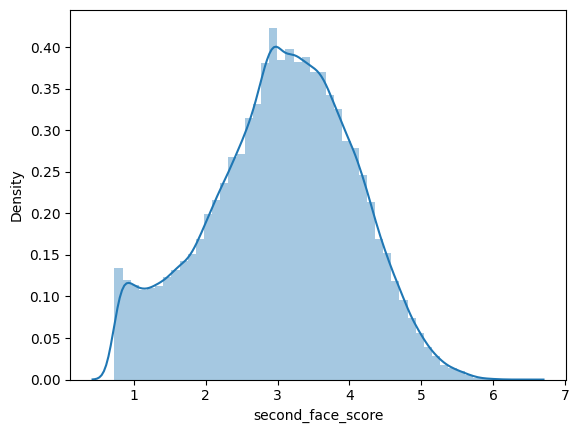

In [17]:
sns.distplot(df['second_face_score'])

In [18]:
percent_of_missing_second_face_score = round(100*df['second_face_score'].isna().sum() / len(df),2)
print(f'Percentage of missing second face scores: {percent_of_missing_second_face_score}%')

Percentage of missing second face scores: 44.84%


 50%|█████     | 2/4 [00:03<00:03,  1.96s/it]


KeyboardInterrupt: 

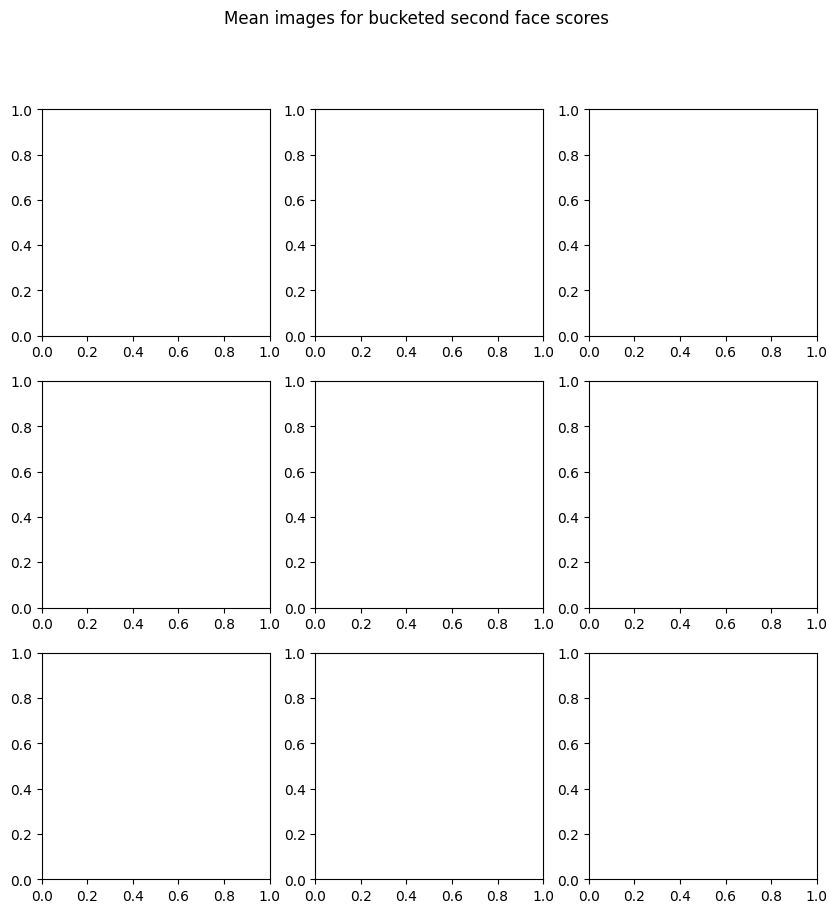

In [19]:
# plot mean image for each bucketed face score
df_second_face_score = df[df['second_face_score'].notnull()].copy()
bucketed_face_scores = pd.cut(df_second_face_score['second_face_score'], bins=9)
df_second_face_score['bucketed_second_face_score'] = bucketed_face_scores
# order buckets
intervals = df_second_face_score['bucketed_second_face_score'].unique()
# sort intervals in ascending order
intervals = sorted(intervals)
# make subplots
fig, axs = plt.subplots(3,3, figsize=(10, 10))
plt.suptitle('Mean images for bucketed second face scores')

for row in range(1,4):
    for col in range(1,4):

        bucket = intervals.pop(0)
        df_bucket = df_second_face_score[df_second_face_score['bucketed_second_face_score'] == bucket]
        percent_of_data = round(100*len(df_bucket) / len(df_second_face_score),2)

        dataset = IMDBDataset(df_bucket, premean=True)
        dataloader = DataLoader(dataset, batch_size=2000, shuffle=True, collate_fn=MyCollate(2000))

        mean_image = calculate_mean_image(dataloader)
        mean_image = mean_image.to('cpu')
        mean_image = mean_image.numpy().astype(int)

        axs[row-1, col-1].imshow(mean_image)
        axs[row-1, col-1].set_title(str(bucket)+' '+str(percent_of_data)+'%')

plt.savefig('Data/mean_images_bucketed_face_scores.png')
plt.show()

In [20]:
# plot mean image for each bucketed face score
df_second_face_score = df[df['second_face_score'].notnull()].copy()
bucketed_face_scores = pd.cut(df_second_face_score['second_face_score'], bins=9)
df_second_face_score['bucketed_second_face_score'] = bucketed_face_scores
# order buckets
intervals = df_second_face_score['bucketed_second_face_score'].unique()
# sort intervals in ascending order
intervals = sorted(intervals)

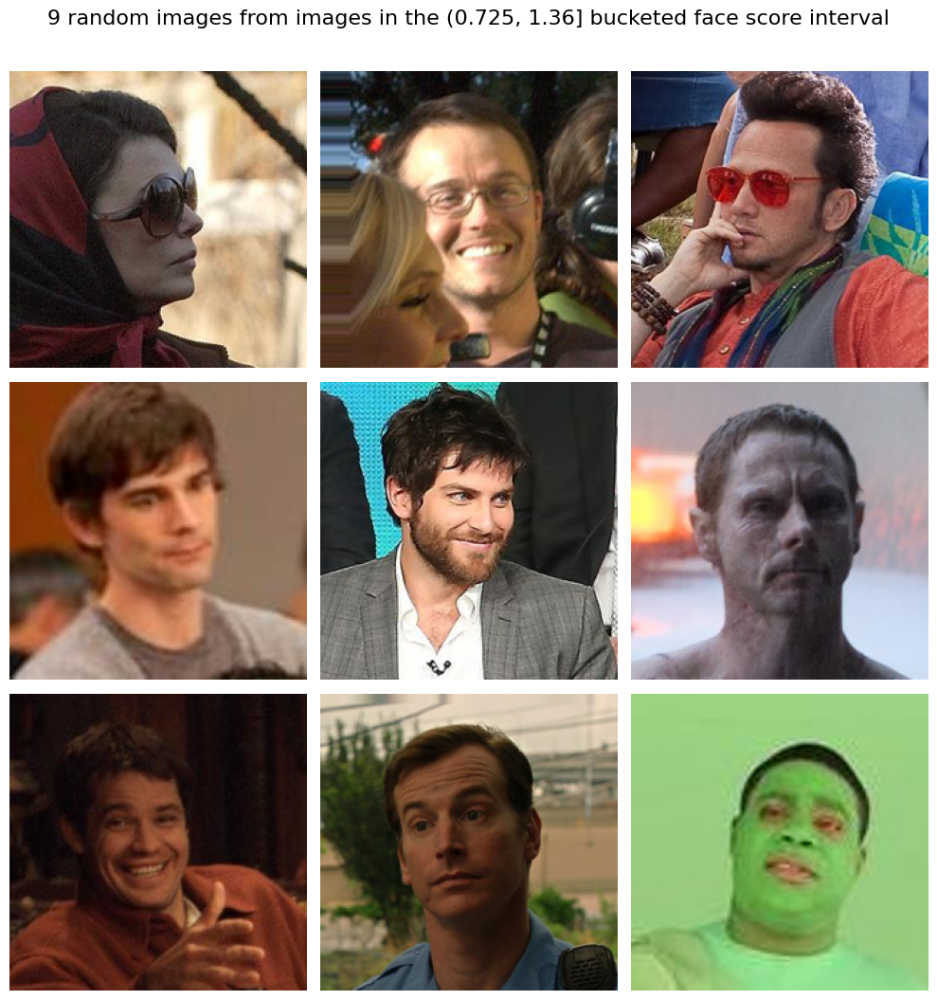

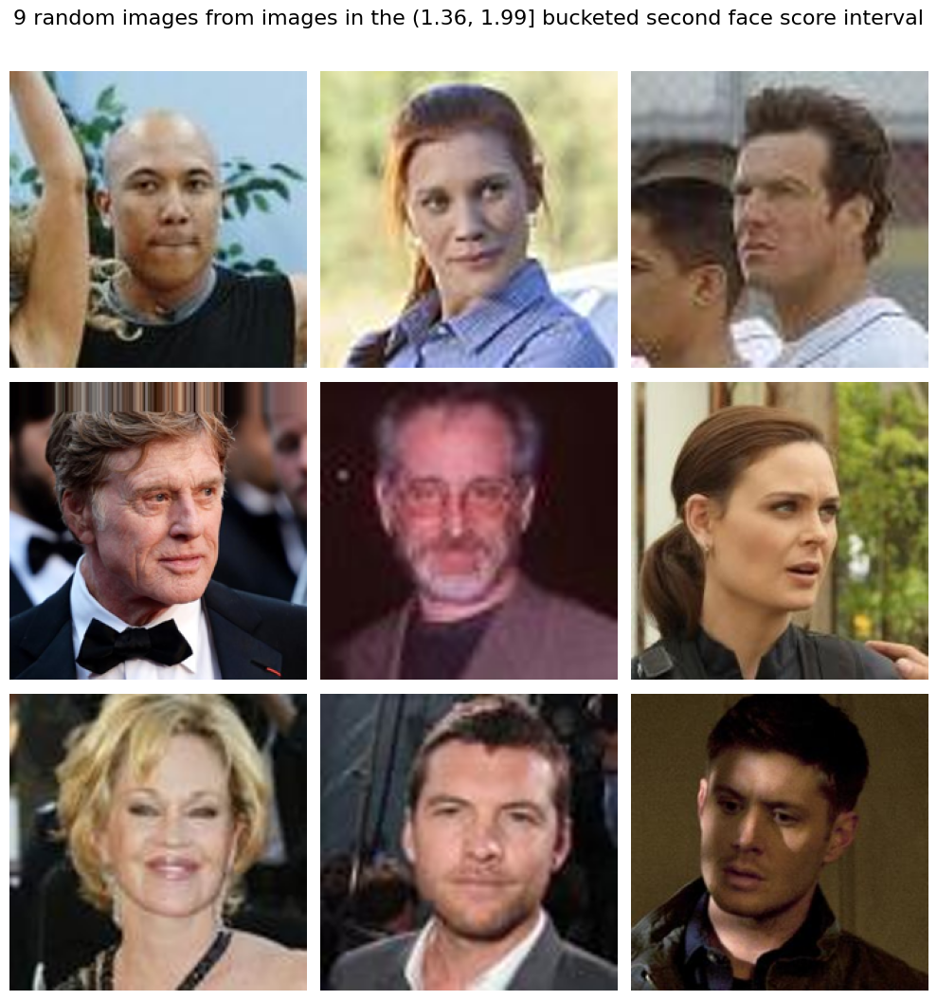

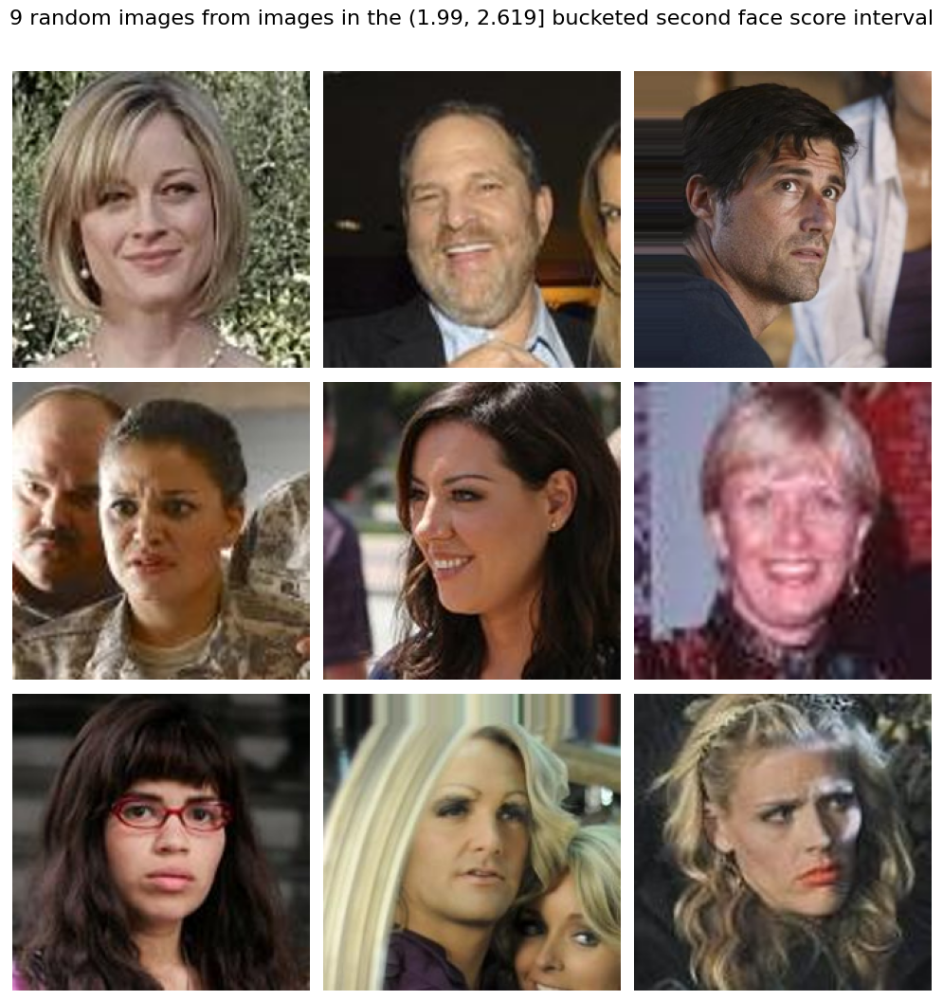

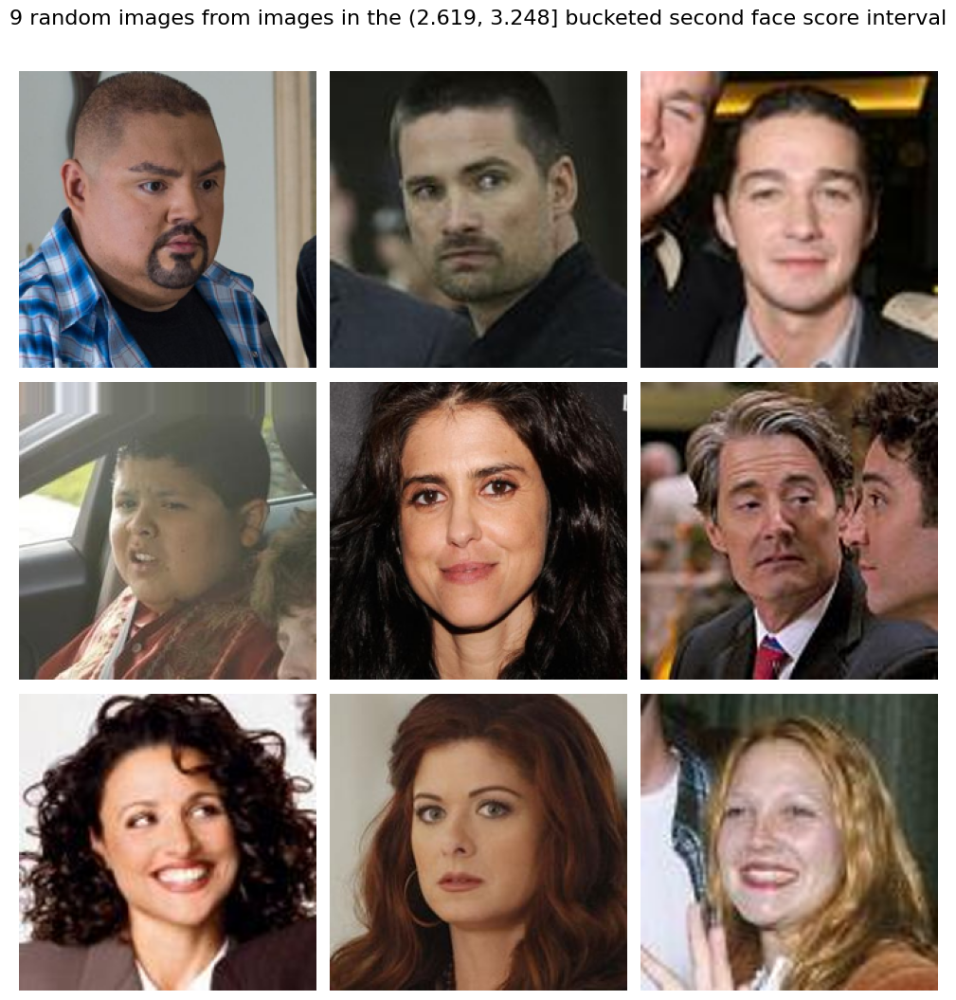

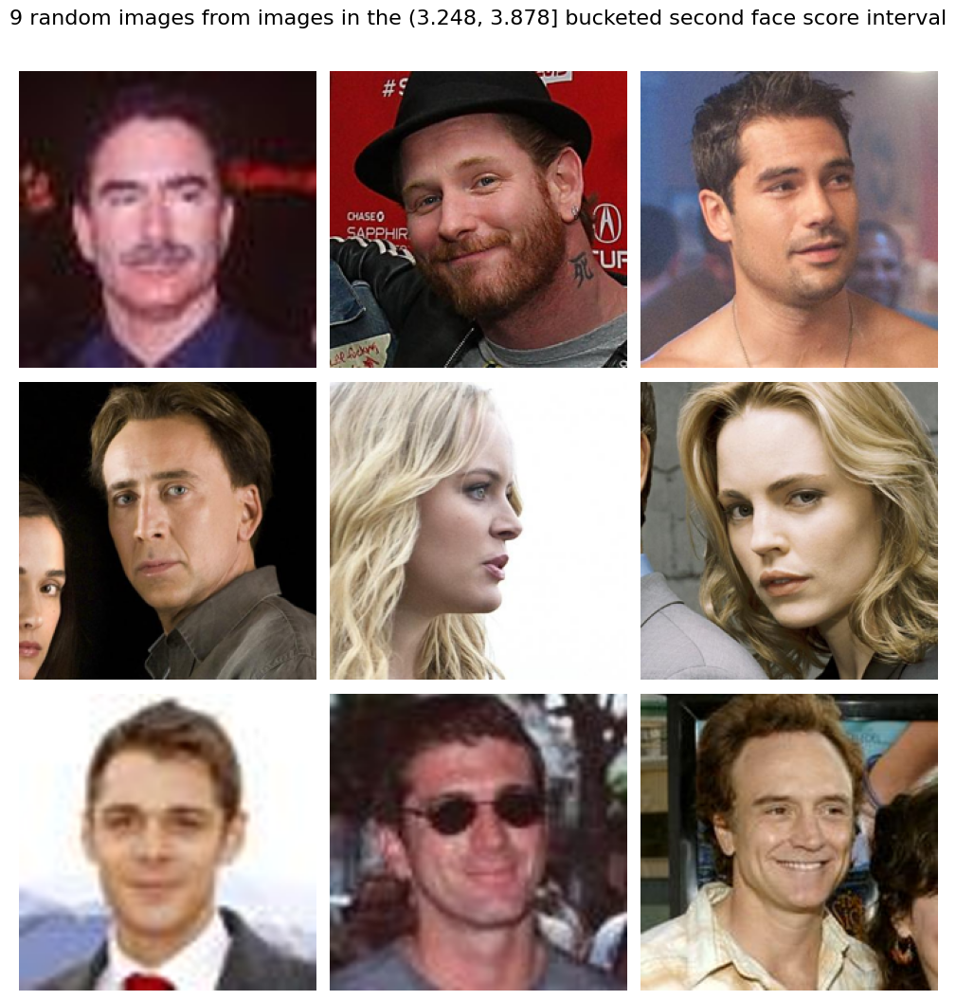

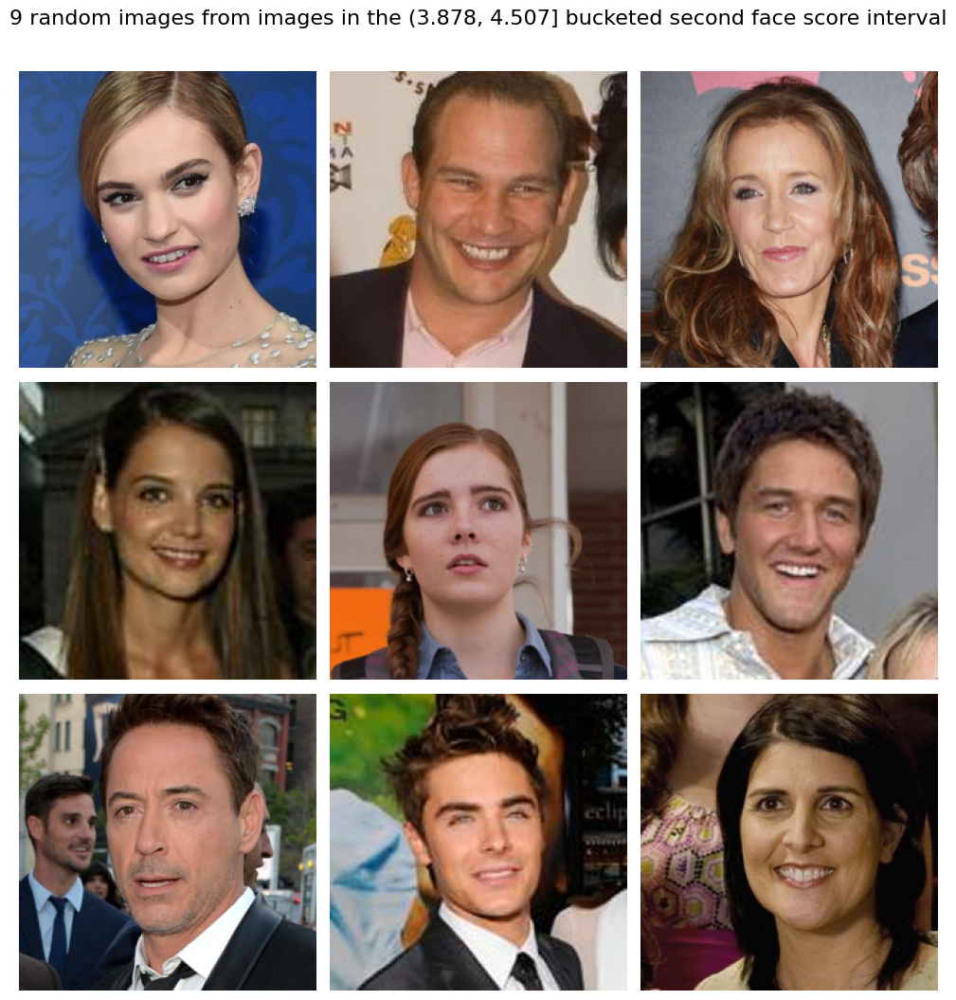

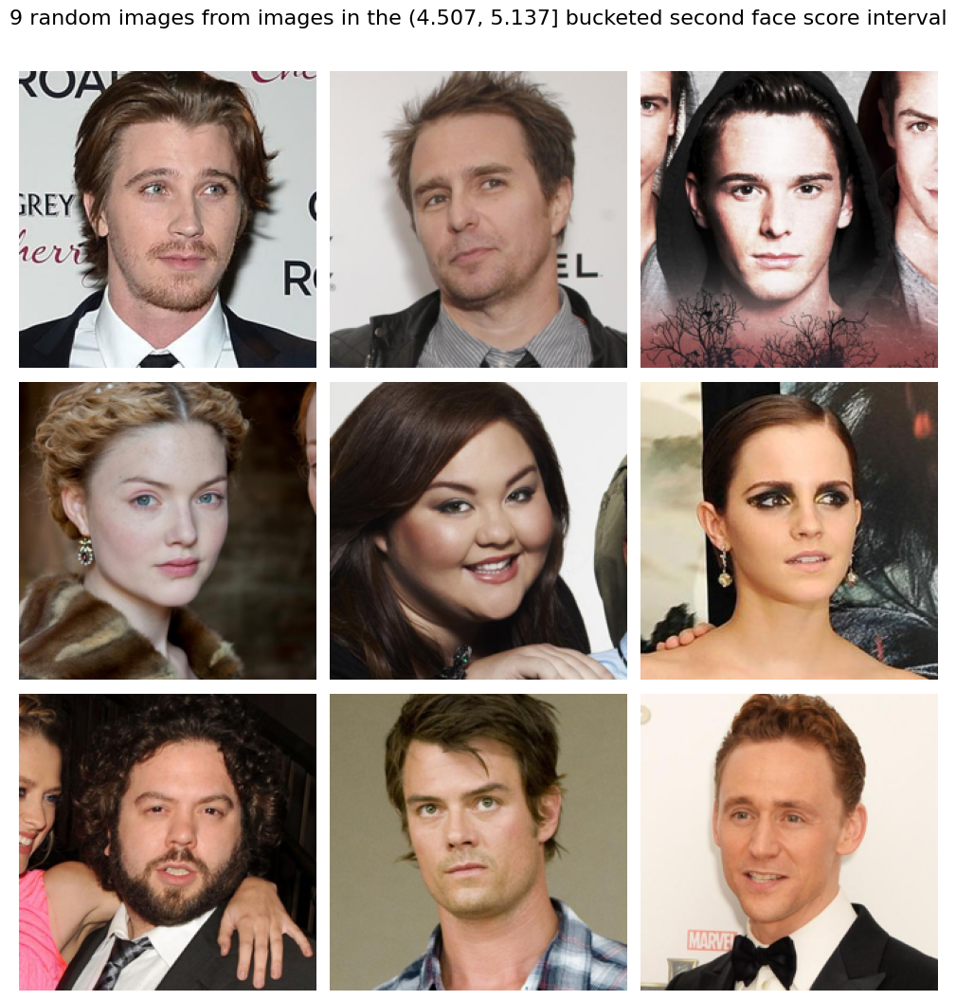

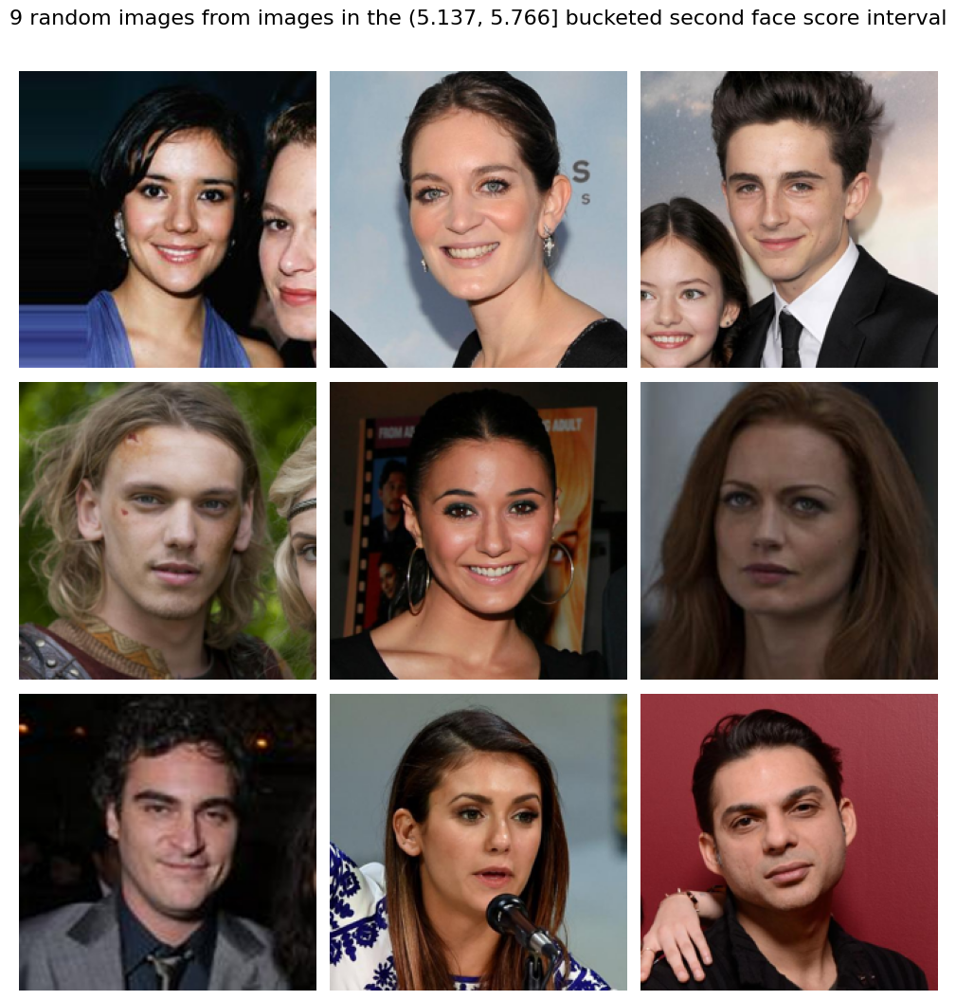

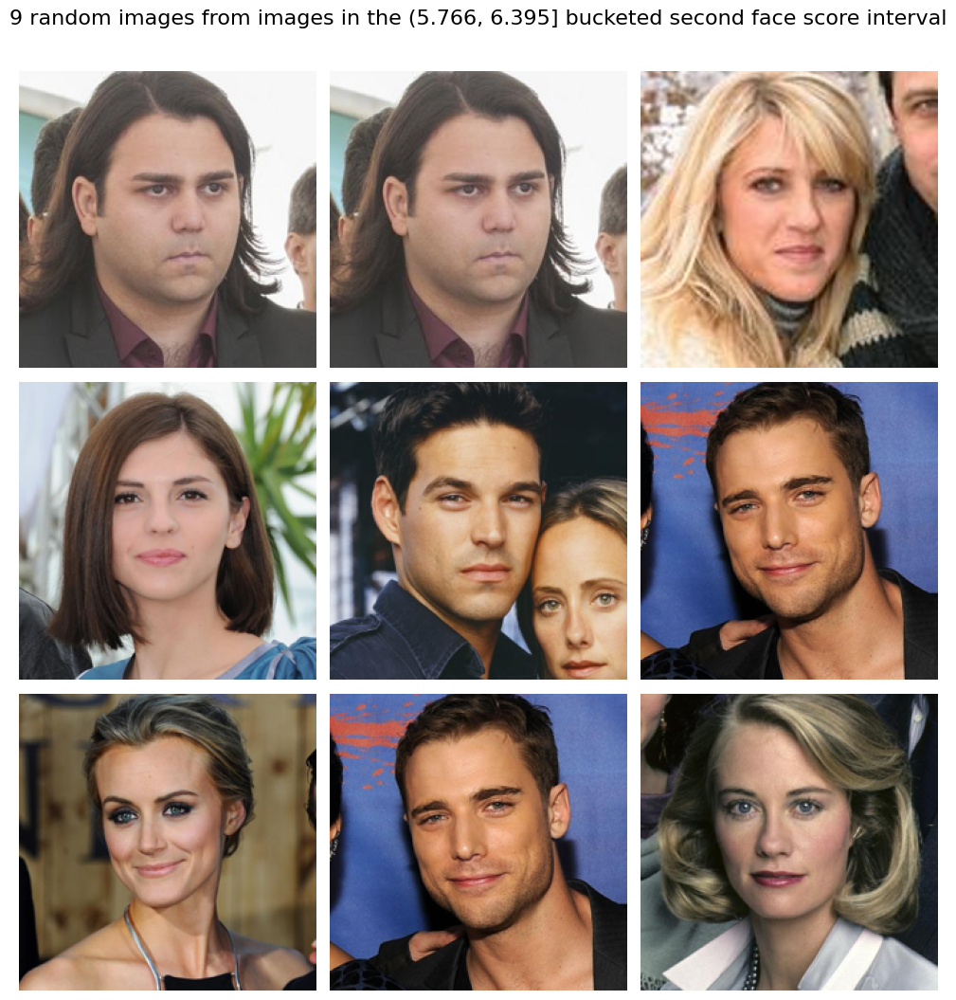

In [13]:
n=8
for interval in intervals:
    df_interval = df_second_face_score[df_second_face_score['bucketed_second_face_score'] == interval]
    dataset = IMDBDataset(df_interval,folder_directory=FILE_PATHS['non_cropped_images_folder'], premean=True)
    dataloader = DataLoader(dataset, batch_size=2000, shuffle=True, collate_fn=MyCollate(2000))
    try:
        plot_top_n_squared_images(dataloader, title=f'{n**2} random images from images in the {str(interval)} bucketed second face score interval', n=n)
    except:
        n = 3
        plot_top_n_squared_images(dataloader, title=f'{n**2} random images from images in the {str(interval)} bucketed face score interval', n=n)

Nothing to really go off of here so we can keep them all

## Number of Celebrities

If there are too many of the same celebrities in the data set we will not have enough variation and our model will not generalise well, so we must consider two things:

1. max number of times celbrity appears at one age
2. max number of times celbrity appears in dataset


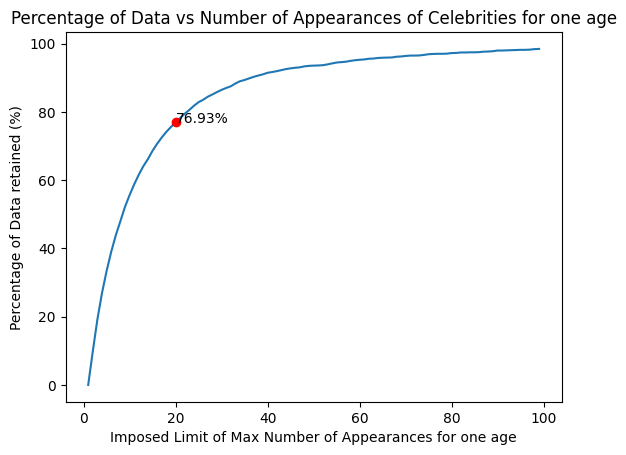

In [21]:
df_celeb_id_age_cnt = df.groupby(['celeb_id', 'age'])[["celeb_id"]].count().rename(columns={'celeb_id':'count'}).reset_index()

cut_off_point = 20
num_iter = 100
number_of_images = df_celeb_id_age_cnt['count'].sum()
percentages_of_data = []

for i in range(1,num_iter):
    df_celeb_id_age_cnt_limited = df_celeb_id_age_cnt[df_celeb_id_age_cnt['count'] >= i]
    number_of_images_in_limited_dataset = df_celeb_id_age_cnt_limited['count'].sum()
    percentage_of_images_in_limited_dataset = 100-round(100*number_of_images_in_limited_dataset/number_of_images,2)
    percentages_of_data.append(percentage_of_images_in_limited_dataset)

    # print(f'If we limit the number of times a celeb_id appears to {i} then we have {percentage_of_images_in_limited_dataset}% of the data')

plt.plot(range(1,num_iter), percentages_of_data)
plt.title('Percentage of Data vs Number of Appearances of Celebrities for one age')
plt.xlabel('Imposed Limit of Max Number of Appearances for one age')
plt.ylabel('Percentage of Data retained (%)')

plt.plot(cut_off_point, percentages_of_data[cut_off_point-1], 'ro')
plt.annotate(f'{percentages_of_data[cut_off_point-1]}%', (cut_off_point, percentages_of_data[cut_off_point-1]))
plt.show()

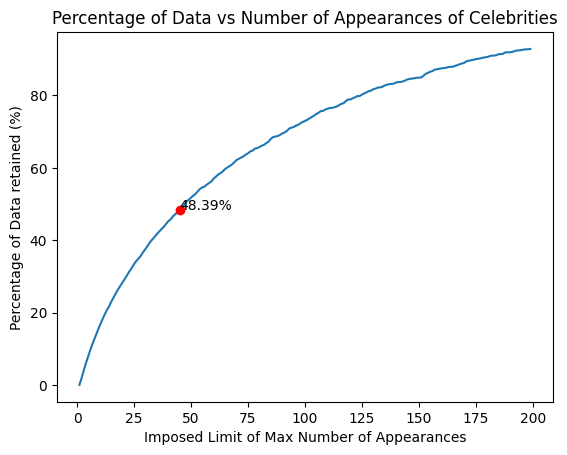

In [22]:
df_celeb_id_cnt = df.groupby(['celeb_id'])[["celeb_id"]].count().rename(columns={'celeb_id':'count'}).reset_index()

cut_off_point = 45
num_iter = 200
number_of_images = df_celeb_id_cnt['count'].sum()
percentages_of_data = []

for i in range(1,num_iter):
    df_celeb_id_cnt_limited = df_celeb_id_cnt[df_celeb_id_cnt['count'] >= i]
    number_of_images_in_limited_dataset = df_celeb_id_cnt_limited['count'].sum()
    percentage_of_images_in_limited_dataset = 100-round(100*number_of_images_in_limited_dataset/number_of_images,2)
    percentages_of_data.append(percentage_of_images_in_limited_dataset)

    # print(f'If we limit the number of times a celeb_id appears to {i} then we have {percentage_of_images_in_limited_dataset}% of the data')   

plt.plot(range(1,num_iter), percentages_of_data)
plt.title('Percentage of Data vs Number of Appearances of Celebrities')
plt.xlabel('Imposed Limit of Max Number of Appearances')
plt.ylabel('Percentage of Data retained (%)')

plt.plot(cut_off_point, percentages_of_data[cut_off_point-1], 'ro')
plt.annotate(f'{percentages_of_data[cut_off_point-1]}%', (cut_off_point, percentages_of_data[cut_off_point-1]))
plt.show()


From looking at graphs best trade off between keeping as much data as possible and ensuring good data quality is:

- 20 - max_num_age_appearances
- 45 - max_num_total_apperences


In [18]:
# TODO: talk about this being a rnaking system?
# TODO: make miro diagram of this

In [23]:
def find_max_num_celeb_id_apperence_by_age(df, id_x, max_num_total_apperences=45, max_num_age_appearances=20):
    """
    Filters down subset of df to only include a max of max_num_total_apperences images of one celeb, whilst taking into account the max number of times a celeb_id can appear for one age

    Args:
        df (pd.DataFrame): dataframe containing celeb_id and age columns
        id_x (int): celeb_id to find max number of times it appears in the dataset by age
        max_num_total_apperences (int, optional): max number of times a celeb_id can appear in the dataset. Defaults to 45.
        max_num_age_appearances (int, optional): max number of times a celeb_id can appear in the dataset for one age. Defaults to 20.
    """
    
    df = df.copy()

    # get value counts of ages for celeb_id x
    df_excess_id_x = df[df['celeb_id'] == id_x]
    value_counts_of_ages_for_celeb_id_x = df_excess_id_x['age'].value_counts().to_frame().reset_index()
    # create theoretical lower bound for max_num_age_apperences if they are evenly distributed
    max_num_age_apperences_lower_bound = max_num_total_apperences//len(value_counts_of_ages_for_celeb_id_x)

    if max_num_age_apperences_lower_bound >= max_num_age_appearances:
        max_num_apperences = max_num_age_appearances
    else:
        # let's loop over max_num_age_appearances and find the first one that gives us a total number of apperences that is greater than max_num_total_apperences
        for max_num_apperences in range(max_num_age_apperences_lower_bound, max_num_age_appearances):
            total_num_apperences = value_counts_of_ages_for_celeb_id_x['age'].apply(lambda x: min(x, max_num_apperences)).sum()
            if total_num_apperences < max_num_total_apperences:
                continue
            else:
                max_num_apperences -= 1
                break

    df_subset = df_excess_id_x.groupby('age').head(max_num_apperences)
    assert df_subset.shape[0] <= max_num_total_apperences

    return df_subset

list_of_all_celeb_ids = df['celeb_id'].unique()
df_filtered = []

for celeb_id in tqdm(list_of_all_celeb_ids):
    df_filtered.append(find_max_num_celeb_id_apperence_by_age(df, celeb_id))

df_filtered = pd.concat(df_filtered)

print(f'Number of images in original dataset: {df.shape[0]}')
print(f'Number of images in filtered dataset: {df_filtered.shape[0]}')

df = df_filtered

100%|██████████| 14091/14091 [01:49<00:00, 128.74it/s]


Number of images in original dataset: 183940
Number of images in filtered dataset: 110295


In [78]:
# TODO: make datacleaning class which takes yaml **kwargs and then does all the data cleaning

In [29]:
# plot boxplots of age distribution split by age, bucketed into 10 year buckets, using plotly
df_plot_gender = df.copy()

df_plot_gender['age_bucket'] = df_plot_gender.apply(lambda x: int(x['age']//10), axis=1)

import plotly.express as px

fig = px.box(df_plot_gender, x='age', y='face_score')
fig.show()


# Gender

In [18]:
# count number of 1 genders vs 0 genders in df_train['gender']
number_of_males = len(df[df['gender']==1])
number_of_females = len(df[df['gender']==0])

# Calculate percentage
percent_of_males = round(100*number_of_males/ len(df),2)
percent_of_females = round(100*number_of_females/ len(df),2)

print(f'{percent_of_males}% of the data is Males')
print(f'{percent_of_females}% of the data is Females')

55.44% of the data is Males
44.56% of the data is Females


In [39]:
df_plot_gender

,image_path,age,gender,face_score,face_locations,celeb_id,second_face_score,dob,date_photo_taken,bucketed_face_scores,age_bucket
0,01/nm0000001_rm124825600_1899-5-10_1968.jpg,69,1,1.459693,[[1072.926 161.838 1214.784 303.696]],6488.0,1.118973,1899-01-01,1968-01-01,"(0.724, 1.47]",6
1,01/nm0000001_rm3343756032_1899-5-10_1970.jpg,71,1,2.543198,[[477.184 100.352 622.592 245.76 ]],6488.0,1.852008,1899-01-01,1970-01-01,"(2.209, 2.948]",7
2,01/nm0000001_rm577153792_1899-5-10_1968.jpg,69,1,3.455579,[[114.96964309 114.96964309 451.68657236 451.6...,6488.0,2.985660,1899-01-01,1968-01-01,"(2.948, 3.687]",6
3,02/nm0000002_rm1075631616_1924-9-16_1991.jpg,67,0,3.490563,[[ 686.67682059 458.46721373 1198.10043604 9...,11516.0,1.345335,1924-01-01,1991-01-01,"(2.948, 3.687]",6
4,02/nm0000002_rm1346607872_1924-9-16_2004.jpg,80,0,3.479189,[[ 78.23569407 52.33512938 194.25423516 168.3...,11516.0,NaN,1924-01-01,2004-01-01,"(2.948, 3.687]",8
...,...,...,...,...,...,...,...,...,...,...,...
263261,08/nm3994408_rm3650268672_1989-12-29_2012.jpg,23,0,4.847264,[[1477.08265846 195.20730051 1633.07408615 3...,8410.0,3.954379,1989-01-01,2012-01-01,"(4.426, 5.165]",2
263262,08/nm3994408_rm3713712128_1989-12-29_2014.jpg,25,0,3.953947,[[1508.83238208 840.00021227 2257.30857312 15...,8410.0,NaN,1989-01-01,2014-01-01,"(3.687, 4.426]",2
263264,08/nm3994408_rm3926507520_1989-12-29_2014.jpg,25,0,1.545827,[[472.86050429 199.69200181 583.5872553 310.4...,8410.0,NaN,1989-01-01,2014-01-01,"(1.47, 2.209]",2
263271,08/nm3994408_rm605006080_1989-12-29_2012.jpg,23,0,4.367861,[[ 788.48 231.424 1081.344 524.288]],8410.0,4.008543,1989-01-01,2012-01-01,"(3.687, 4.426]",2


## Age

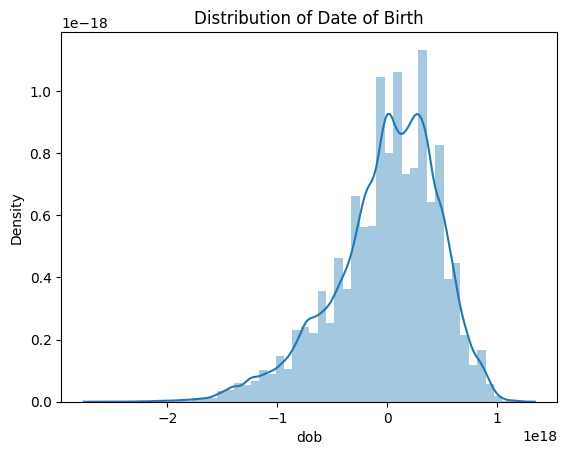

In [42]:
sns.distplot(df['dob'])
plt.title('Distribution of Date of Birth')
plt.show()

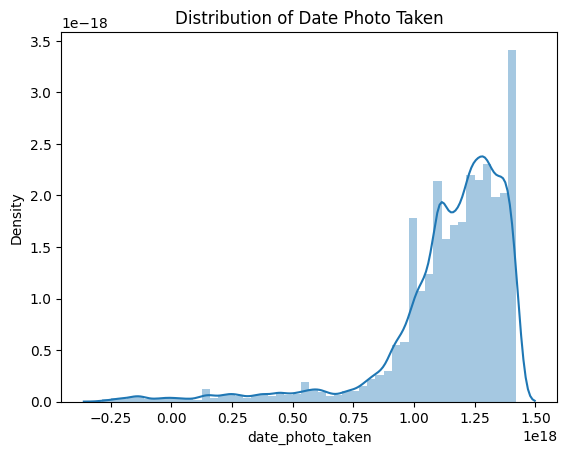

In [43]:
sns.distplot(df['date_photo_taken'])
plt.title('Distribution of Date Photo Taken')
plt.show()

<Axes: xlabel='date_photo_taken', ylabel='face_score'>

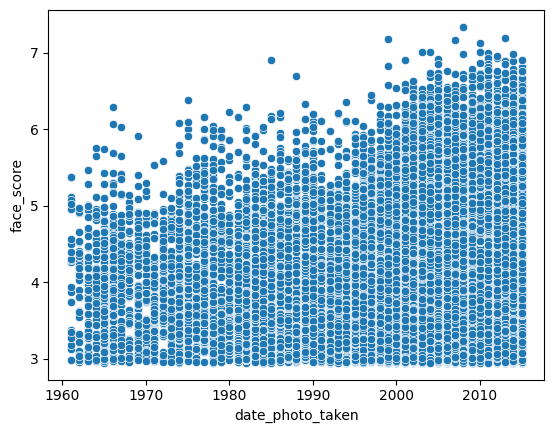

In [44]:
# Lets see if this affects the face score
sns.scatterplot(x='date_photo_taken', y='face_score', data=df)

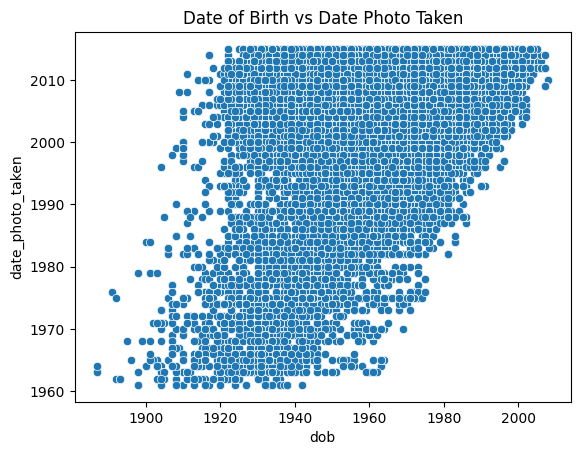

In [45]:
sns.scatterplot(x='dob', y='date_photo_taken', data=df)
plt.title('Date of Birth vs Date Photo Taken')
plt.show()

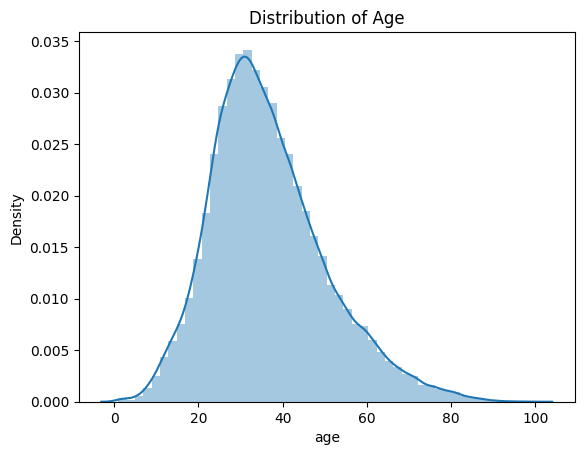

In [46]:
sns.distplot(df['age'])
plt.title('Distribution of Age')
plt.show()

In [ ]:
# TODO: create a generate train_test function which processes this metadata with all considerations in this notebook